<a href="https://colab.research.google.com/github/shihwesley/CMPE255/blob/main/pycaret_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install pycaret

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 320 kB 5.2 MB/s 
     |████████████████████████████████| 2.0 MB 36.9 MB/s 
     |████████████████████████████████| 1.3 MB 51.2 MB/s 
     |████████████████████████████████| 167 kB 54.1 MB/s 
     |████████████████████████████████| 636 kB 54.8 MB/s 
     |████████████████████████████████| 3.3 MB 38.5 MB/s 
     |████████████████████████████████| 6.8 MB 24.2 MB/s 
     |████████████████████████████████| 10.4 MB 25.1 MB/s 
     |████████████████████████████████| 134 kB 58.8 MB/s 
     |████████████████████████████████| 17.0 MB 46.0 MB/s 
     |████████████████████████████████| 268 kB 58.2 MB/s 
     |████████████████████████████████| 88 kB 7.1 MB/s 
     |████████████████████████████████| 25.9 MB 1.5 MB/s 
     |████████████████████████████████| 56 kB 4.5 MB/s 
     |████████████████████████████████| 1.7 MB 46.2 MB/s 
  Installing build dependencies ..

In [1]:
from pycaret.utils import enable_colab
enable_colab()

Colab mode enabled.


In [2]:
from pycaret.datasets import get_data
dataset = get_data('credit')

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default
0,20000,2,2,1,24,2,2,-1,-1,-2,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,90000,2,2,2,34,0,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
2,50000,2,2,1,37,0,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
3,50000,1,2,1,57,-1,0,-1,0,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0
4,50000,1,1,2,37,0,0,0,0,0,...,19394.0,19619.0,20024.0,2500.0,1815.0,657.0,1000.0,1000.0,800.0,0


In [ ]:
# check the shape of data returns 24000 rows * 24 columns
dataset.shape

(24000, 24)

In [3]:
data = dataset.sample(frac=0.95, random_state = 786)
data_unseen = dataset.drop(data.index)
data.reset_index(inplace = True, drop = True)
data_unseen.reset_index(inplace = True, drop = True)
print('Data for Modeling: ' + str(data.shape))
print('Unseen Data for Predictions: '+ str(data_unseen.shape))

Data for Modeling: (22800, 24)
Unseen Data for Predictions: (1200, 24)


In [4]:
from pycaret.classification import * 

In [5]:
exp_clf101 = setup(data = data, target = 'default', session_id=123)

INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: classification
INFO:logs:version 2.3.10
INFO:logs:Initializing setup()
INFO:logs:setup(target=default, ml_usecase=classification, available_plots={'parameter': 'Hyperparameters', 'auc': 'AUC', 'confusion_matrix': 'Confusion Matrix', 'threshold': 'Threshold', 'pr': 'Precision Recall', 'error': 'Prediction Error', 'class_report': 'Class Report', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'calibration': 'Calibration Curve', 'vc': 'Validation Curve', 'dimension': 'Dimensions', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'boundary': 'Decision Boundary', 'lift': 'Lift Chart', 'gain': 'Gain Chart', 'tree': 'Decision Tree', 'ks': 'KS Statistic Plot'}, train_size=0.7, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=None, categorical_imputation=constant, categorical_iterative_imputer=lightgbm, ordinal

IntProgress(value=0, description='Processing: ', max=3)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,04:08:53
Status,. . . . . . . . . . . . . . . . . .,Preprocessing Data


INFO:logs:Importing libraries
INFO:logs:Copying data for preprocessing
INFO:logs:Declaring preprocessing parameters
INFO:logs:Creating preprocessing pipeline
INFO:logs:Preprocessing pipeline created successfully
ERROR:logs:(Process Exit): setup has been interupted with user command 'quit'. setup must rerun.
INFO:logs:Creating global containers
INFO:logs:Internal pipeline: Pipeline(memory=None, steps=[('empty_step', 'passthrough')], verbose=False)


Text(value="Following data types have been inferred automatically, if they are correct press enter to continue…

,Data Type
LIMIT_BAL,Numeric
SEX,Categorical
EDUCATION,Categorical
MARRIAGE,Categorical
AGE,Numeric
PAY_1,Categorical
PAY_2,Categorical
PAY_3,Categorical
PAY_4,Categorical
PAY_5,Categorical


KeyboardInterrupt: ignored

In [ ]:
best_model = compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.8254,0.0000,0.3637,0.6913,0.4764,0.3836,0.4122,0.050
lda,Linear Discriminant Analysis,0.8247,0.7634,0.3755,0.6794,0.4835,0.3884,0.4132,0.303
gbc,Gradient Boosting Classifier,0.8226,0.7789,0.3551,0.6806,0.4664,0.3725,0.4010,6.085
ada,Ada Boost Classifier,0.8221,0.7697,0.3505,0.6811,0.4626,0.3690,0.3983,1.328
lightgbm,Light Gradient Boosting Machine,0.8210,0.7750,0.3609,0.6679,0.4683,0.3721,0.3977,0.455
rf,Random Forest Classifier,0.8199,0.7598,0.3663,0.6601,0.4707,0.3727,0.3965,3.065
et,Extra Trees Classifier,0.8092,0.7377,0.3677,0.6047,0.4571,0.3497,0.3657,2.440
lr,Logistic Regression,0.7814,0.6410,0.0003,0.1000,0.0006,0.0003,0.0034,1.200
dummy,Dummy Classifier,0.7814,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.032
knn,K Neighbors Classifier,0.7547,0.5939,0.1763,0.3719,0.2388,0.1145,0.1259,0.953


INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001)
INFO:logs:compare_models() succesfully completed......................................


In [ ]:
ridge = create_model('ridge')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8195,0.0,0.3553,0.6631,0.4627,0.3659,0.3917
1,0.8327,0.0,0.3897,0.7158,0.5046,0.4144,0.4421
2,0.8239,0.0,0.3381,0.7024,0.4565,0.3664,0.4014
3,0.8277,0.0,0.3639,0.7056,0.4802,0.3893,0.4200
4,0.8208,0.0,0.3582,0.6684,0.4664,0.3703,0.3964
5,0.8340,0.0,0.3954,0.7188,0.5102,0.4202,0.4474
6,0.8239,0.0,0.3668,0.6809,0.4767,0.3821,0.4086
7,0.8239,0.0,0.3381,0.7024,0.4565,0.3664,0.4014
8,0.8214,0.0,0.3553,0.6739,0.4653,0.3702,0.3976


INFO:logs:create_model_container: 16
INFO:logs:master_model_container: 16
INFO:logs:display_container: 4
INFO:logs:RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001)
INFO:logs:create_model() succesfully completed......................................


In [ ]:
tuned_ridge = tune_model(ridge)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8195,0.0,0.3553,0.6631,0.4627,0.3659,0.3917
1,0.8321,0.0,0.3897,0.7120,0.5037,0.4129,0.4401
2,0.8233,0.0,0.3381,0.6982,0.4556,0.3650,0.3993
3,0.8277,0.0,0.3639,0.7056,0.4802,0.3893,0.4200
4,0.8208,0.0,0.3553,0.6703,0.4644,0.3688,0.3956
5,0.8346,0.0,0.3983,0.7202,0.5129,0.4231,0.4500
6,0.8239,0.0,0.3696,0.6789,0.4787,0.3836,0.4093
7,0.8246,0.0,0.3381,0.7066,0.4574,0.3679,0.4035
8,0.8214,0.0,0.3553,0.6739,0.4653,0.3702,0.3976


INFO:logs:create_model_container: 17
INFO:logs:master_model_container: 17
INFO:logs:display_container: 5
INFO:logs:RidgeClassifier(alpha=2.81, class_weight=None, copy_X=True, fit_intercept=False,
                max_iter=None, normalize=True, random_state=123, solver='auto',
                tol=0.001)
INFO:logs:tune_model() succesfully completed......................................


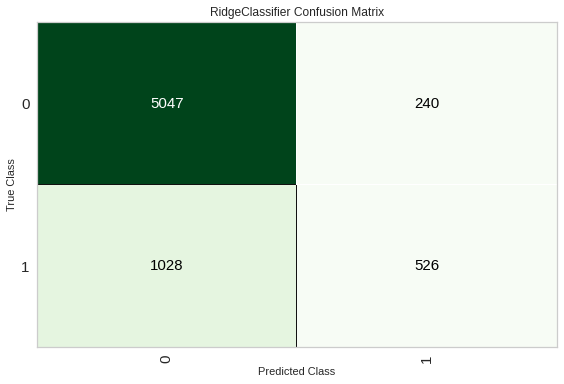

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(tuned_ridge, plot = 'confusion_matrix')

In [ ]:
predict_model(tuned_ridge)

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=RidgeClassifier(alpha=2.81, class_weight=None, copy_X=True, fit_intercept=False,
                max_iter=None, normalize=True, random_state=123, solver='auto',
                tol=0.001), probability_threshold=None, encoded_labels=False, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Ridge Classifier,0.8146,0.6465,0.3385,0.6867,0.4534,0.357,0.3894


,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,...,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8,default,Label
0,80000.0,29.0,6228.0,589.0,390.0,390.0,390.0,383.0,589.0,390.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
1,180000.0,30.0,149069.0,152317.0,156282.0,161163.0,172190.0,148963.0,7500.0,8000.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0
2,100000.0,26.0,18999.0,23699.0,9390.0,5781.0,8065.0,17277.0,5129.0,1227.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
3,500000.0,36.0,396.0,1043.0,19230.0,116696.0,194483.0,195454.0,1043.0,19230.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
4,190000.0,47.0,192493.0,193297.0,193400.0,193278.0,192956.0,193039.0,7200.0,7222.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6836,120000.0,44.0,75294.0,76465.0,74675.0,79629.0,77748.0,82497.0,3000.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1
6837,50000.0,26.0,47095.0,48085.0,49039.0,49662.0,0.0,0.0,2073.0,2027.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
6838,80000.0,39.0,46401.0,39456.0,30712.0,29629.0,28241.0,28030.0,1560.0,1421.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
6839,200000.0,33.0,50612.0,10537.0,5552.0,2506.0,9443.0,11818.0,10023.0,27.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0


In [ ]:
predict_model(final_ridge)

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=RidgeClassifier(alpha=2.81, class_weight=None, copy_X=True, fit_intercept=False,
                max_iter=None, normalize=True, random_state=123, solver='auto',
                tol=0.001), probability_threshold=None, encoded_labels=False, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Ridge Classifier,0.8151,0.6475,0.3404,0.6879,0.4554,0.359,0.3913


,LIMIT_BAL,AGE,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,...,PAY_6_0,PAY_6_2,PAY_6_3,PAY_6_4,PAY_6_5,PAY_6_6,PAY_6_7,PAY_6_8,default,Label
0,80000.0,29.0,6228.0,589.0,390.0,390.0,390.0,383.0,589.0,390.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
1,180000.0,30.0,149069.0,152317.0,156282.0,161163.0,172190.0,148963.0,7500.0,8000.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1,0
2,100000.0,26.0,18999.0,23699.0,9390.0,5781.0,8065.0,17277.0,5129.0,1227.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
3,500000.0,36.0,396.0,1043.0,19230.0,116696.0,194483.0,195454.0,1043.0,19230.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
4,190000.0,47.0,192493.0,193297.0,193400.0,193278.0,192956.0,193039.0,7200.0,7222.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6836,120000.0,44.0,75294.0,76465.0,74675.0,79629.0,77748.0,82497.0,3000.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1
6837,50000.0,26.0,47095.0,48085.0,49039.0,49662.0,0.0,0.0,2073.0,2027.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
6838,80000.0,39.0,46401.0,39456.0,30712.0,29629.0,28241.0,28030.0,1560.0,1421.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0
6839,200000.0,33.0,50612.0,10537.0,5552.0,2506.0,9443.0,11818.0,10023.0,27.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0


In [ ]:
unseen_predictions = predict_model(final_ridge, data = data_unseen)
unseen_predictions.head()

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=RidgeClassifier(alpha=2.81, class_weight=None, copy_X=True, fit_intercept=False,
                max_iter=None, normalize=True, random_state=123, solver='auto',
                tol=0.001), probability_threshold=None, encoded_labels=False, drift_report=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None, drift_kwargs=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Ridge Classifier,0.8108,0.6491,0.3612,0.6169,0.4556,0.3505,0.3689


,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default,Label
0,100000,2,2,2,23,0,-1,-1,0,0,...,-159.0,567.0,380.0,601.0,0.0,581.0,1687.0,1542.0,0,0
1,380000,1,2,2,32,-1,-1,-1,-1,-1,...,11849.0,11873.0,21540.0,15138.0,24677.0,11851.0,11875.0,8251.0,0,0
2,200000,2,2,1,32,-1,-1,-1,-1,2,...,3848.0,3151.0,5818.0,15.0,9102.0,17.0,3165.0,1395.0,0,0
3,200000,1,1,1,53,2,2,2,2,2,...,147124.0,149531.0,6300.0,5500.0,5500.0,5500.0,5000.0,5000.0,1,1
4,240000,1,1,2,41,1,-1,-1,0,0,...,360.0,1737.0,2622.0,3301.0,0.0,360.0,1737.0,924.0,0,0


save_model(final_ridge, 'Final Ridge Model Sept 2022')

In [6]:
from pycaret.datasets import get_data
dataset = get_data('credit', profile = True)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
dataset.shape

(24000, 24)

In [7]:
data = dataset.sample(frac=0.95, random_state=786)
data_unseen = dataset.drop(data.index)

data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (22800, 24)
Unseen Data For Predictions: (1200, 24)


In [8]:
!pip install numpy
from pycaret.classification import *

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [9]:
exp_clf102 = setup(data = data, target = 'default', session_id=123,
                  normalize = True, 
                  transformation = True, 
                  ignore_low_variance = True,
                  remove_multicollinearity = True, multicollinearity_threshold = 0.95,
                  bin_numeric_features = ['LIMIT_BAL', 'AGE'],
                  group_features = [['BILL_AMT1', 'BILL_AMT2','BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'],
                                   ['PAY_AMT1','PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']],
                  log_experiment = True, experiment_name = 'credit1')

,Description,Value
0,session_id,123
1,Target,default
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(22800, 24)"
5,Missing Values,False
6,Numeric Features,14
7,Categorical Features,9
8,Ordinal Features,False
9,High Cardinality Features,False


INFO:logs:Logging experiment in MLFlow
2022/09/09 04:22:02 INFO mlflow.tracking.fluent: Experiment with name 'credit1' does not exist. Creating a new experiment.
INFO:logs:SubProcess save_model() called ==================================
INFO:logs:Initializing save_model()
INFO:logs:save_model(model=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='default',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                nu

In [10]:
top3 = compare_models(n_select = 3, fold = 5)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
ridge,Ridge Classifier,0.8254,0.0000,0.3588,0.6949,0.4732,0.3810,0.4110,0.072
lda,Linear Discriminant Analysis,0.8244,0.7704,0.3792,0.6751,0.4855,0.3896,0.4132,0.574
svm,SVM - Linear Kernel,0.8238,0.0000,0.3353,0.7039,0.4541,0.3645,0.4002,0.732
lr,Logistic Regression,0.8234,0.7715,0.3568,0.6842,0.4690,0.3754,0.4041,1.708
gbc,Gradient Boosting Classifier,0.8232,0.7763,0.3574,0.6828,0.4692,0.3753,0.4037,7.772
ada,Ada Boost Classifier,0.8228,0.7711,0.3394,0.6941,0.4557,0.3644,0.3979,1.750
lightgbm,Light Gradient Boosting Machine,0.8208,0.7703,0.3606,0.6674,0.4679,0.3715,0.3971,0.702
rf,Random Forest Classifier,0.8199,0.7578,0.3565,0.6643,0.4639,0.3673,0.3930,3.376
et,Extra Trees Classifier,0.8182,0.7498,0.3723,0.6462,0.4722,0.3718,0.3926,3.404
nb,Naive Bayes,0.7951,0.7452,0.4081,0.5679,0.4582,0.3394,0.3547,0.076


INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=123, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)]
INFO:logs:compare_models() succesfully completed......................................


In [11]:
type(top3)

list

In [12]:
print(top3)

[RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001), SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=123, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)]


In [13]:
dt = create_model('dt', fold = 3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7278,0.6147,0.4093,0.3848,0.3967,0.2212,0.2213
1,0.7271,0.6155,0.4162,0.3850,0.4000,0.2237,0.2240
2,0.7325,0.6173,0.4110,0.3931,0.4018,0.2297,0.2298
Mean,0.7291,0.6159,0.4122,0.3876,0.3995,0.2248,0.2250
Std,0.0024,0.0011,0.0029,0.0039,0.0021,0.0036,0.0035


INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 3
INFO:logs:DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=123, splitter='best')
INFO:logs:create_model() succesfully completed......................................


In [14]:
bagged_dt = ensemble_model(dt)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8076,0.7274,0.3324,0.6105,0.4304,0.3266,0.3485
1,0.8164,0.7257,0.3668,0.6400,0.4663,0.3652,0.3858
2,0.8064,0.7171,0.3009,0.6176,0.4046,0.3051,0.3333
3,0.8120,0.7362,0.3496,0.6256,0.4485,0.3460,0.3673
4,0.8114,0.7328,0.3181,0.6379,0.4245,0.3265,0.3548
5,0.8139,0.7218,0.3553,0.6327,0.4550,0.3533,0.3747
6,0.7957,0.7204,0.3037,0.5608,0.3941,0.2841,0.3034
7,0.8102,0.7297,0.3152,0.6322,0.4207,0.3220,0.3499
8,0.8058,0.7104,0.3095,0.6102,0.4106,0.3089,0.3345


INFO:logs:create_model_container: 16
INFO:logs:master_model_container: 16
INFO:logs:display_container: 4
INFO:logs:BaggingClassifier(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                        class_weight=None,
                                                        criterion='gini',
                                                        max_depth=None,
                                                        max_features=None,
                                                        max_leaf_nodes=None,
                                                        min_impurity_decrease=0.0,
                                                        min_impurity_split=None,
                                                        min_samples_leaf=1,
                                                        min_samples_split=2,
                                                        min_weight_fraction_leaf=0.0,
                                      

In [15]:
boosted_dt = ensemble_model(dt, method = 'Boosting')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7538,0.6603,0.3524,0.4241,0.3850,0.2327,0.2342
1,0.7807,0.6989,0.3582,0.4980,0.4167,0.2860,0.2919
2,0.7920,0.6936,0.3324,0.5395,0.4113,0.2936,0.3063
3,0.7625,0.6718,0.3438,0.4444,0.3877,0.2434,0.2465
4,0.7644,0.7111,0.3754,0.4533,0.4107,0.2651,0.2669
5,0.7556,0.6739,0.3524,0.4286,0.3868,0.2360,0.2378
6,0.7607,0.6549,0.2779,0.4273,0.3368,0.1987,0.2055
7,0.7769,0.6728,0.2636,0.4817,0.3407,0.2201,0.2346
8,0.7575,0.6727,0.3610,0.4345,0.3944,0.2444,0.2460


INFO:logs:create_model_container: 17
INFO:logs:master_model_container: 17
INFO:logs:display_container: 5
INFO:logs:AdaBoostClassifier(algorithm='SAMME.R',
                   base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                         class_weight=None,
                                                         criterion='gini',
                                                         max_depth=None,
                                                         max_features=None,
                                                         max_leaf_nodes=None,
                                                         min_impurity_decrease=0.0,
                                                         min_impurity_split=None,
                                                         min_samples_leaf=1,
                                                         min_samples_split=2,
                                                         min_weight_fracti

In [16]:
lightgbm = create_model('lightgbm', verbose = False, fold = 3)
dt = create_model('dt', verbose = False, fold = 3)
lr = create_model('lr', verbose = False, fold = 3)

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=3, round=4, cross_validation=True, predict=True, fit_kwargs=None, groups=None, refit=True, verbose=False, system=True, metrics=None, experiment_custom_tags=None, add_to_model_list=True, probability_threshold=None, display=None, return_train_score=False, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient Boosting Machine Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with StratifiedKFold(n_splits=3, random_state=None, shuffle=False), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Finalizing model
INFO:logs:Creating Dashboard logs
INFO:logs:Model: Light Gradient Boosting Machine
INFO:logs:logged params: {'boosting_type': 'gbdt', 'class_weight': Non

In [17]:
blend_soft = blend_models(estimator_list = [lightgbm, dt, lr], method = 'soft', fold = 3)


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8008,0.7512,0.3603,0.5701,0.4415,0.3277,0.3405
1,0.8051,0.7668,0.3835,0.5822,0.4624,0.3495,0.3608
2,0.8018,0.7451,0.3525,0.5767,0.4376,0.3257,0.3402
Mean,0.8026,0.7544,0.3654,0.5763,0.4472,0.3343,0.3472
Std,0.0018,0.0091,0.0132,0.0050,0.0109,0.0108,0.0097


INFO:logs:create_model_container: 21
INFO:logs:master_model_container: 21
INFO:logs:display_container: 9
INFO:logs:VotingClassifier(estimators=[('lightgbm',
                              LGBMClassifier(boosting_type='gbdt',
                                             class_weight=None,
                                             colsample_bytree=1.0,
                                             importance_type='split',
                                             learning_rate=0.1, max_depth=-1,
                                             min_child_samples=20,
                                             min_child_weight=0.001,
                                             min_split_gain=0.0,
                                             n_estimators=100, n_jobs=-1,
                                             num_leaves=31, objective=None,
                                             random_state=123, reg_alpha=0.0,
                                             reg_lambda=0.0, silent=

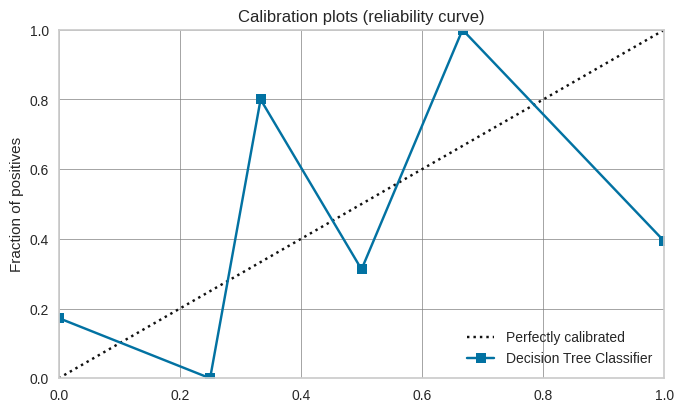

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [18]:
plot_model(dt, plot = 'calibration')

In [19]:
calibrated_rf = calibrate_model(dt)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7813,0.6945,0.0,0.0,0.0,0.0,0.0
1,0.7813,0.7251,0.0,0.0,0.0,0.0,0.0
2,0.7813,0.7033,0.0,0.0,0.0,0.0,0.0
3,0.7813,0.7015,0.0,0.0,0.0,0.0,0.0
4,0.7813,0.6937,0.0,0.0,0.0,0.0,0.0
5,0.7813,0.7107,0.0,0.0,0.0,0.0,0.0
6,0.7813,0.7066,0.0,0.0,0.0,0.0,0.0
7,0.7813,0.6873,0.0,0.0,0.0,0.0,0.0
8,0.7813,0.6980,0.0,0.0,0.0,0.0,0.0


INFO:logs:create_model_container: 22
INFO:logs:master_model_container: 22
INFO:logs:display_container: 10
INFO:logs:CalibratedClassifierCV(base_estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                             class_weight=None,
                                                             criterion='gini',
                                                             max_depth=None,
                                                             max_features=None,
                                                             max_leaf_nodes=None,
                                                             min_impurity_decrease=0.0,
                                                             min_impurity_split=None,
                                                             min_samples_leaf=1,
                                                             min_samples_split=2,
                                                             min_weight_f

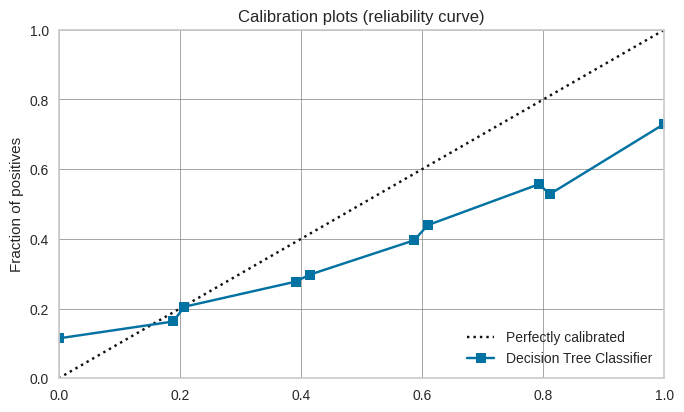

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [20]:
plot_model(calibrated_rf, plot='calibration')

Here we are going to do our own example that we are going find from kaggle

In [22]:
!pip install numpy as np
!pip install pandas as pd

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement as (from versions: none)
ERROR: No matching distribution found for as
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement as (from versions: none)
ERROR: No matching distribution found for as


In [28]:
from google.colab import files
uploaded = files.upload()



Saving heart.csv to heart.csv


In [30]:
import io 
heart_data = pd.read_csv(io.BytesIO(uploaded['heart.csv']))


In [31]:
from pycaret.classification import *

In [32]:
heart_data.head()

,age,sex,cp,trtbps,chol,fbs,restecg,thalachh,exng,oldpeak,slp,caa,thall,output
0,63,1,3,145,233,1,0,150,0,2.3,0,0,1,1
1,37,1,2,130,250,0,1,187,0,3.5,0,0,2,1
2,41,0,1,130,204,0,0,172,0,1.4,2,0,2,1
3,56,1,1,120,236,0,1,178,0,0.8,2,0,2,1
4,57,0,0,120,354,0,1,163,1,0.6,2,0,2,1


In [43]:
heart_data.shape

(303, 14)

In [45]:
heart_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 303 entries, 0 to 302
Data columns (total 14 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       303 non-null    int64  
 1   sex       303 non-null    int64  
 2   cp        303 non-null    int64  
 3   trtbps    303 non-null    int64  
 4   chol      303 non-null    int64  
 5   fbs       303 non-null    int64  
 6   restecg   303 non-null    int64  
 7   thalachh  303 non-null    int64  
 8   exng      303 non-null    int64  
 9   oldpeak   303 non-null    float64
 10  slp       303 non-null    int64  
 11  caa       303 non-null    int64  
 12  thall     303 non-null    int64  
 13  output    303 non-null    int64  
dtypes: float64(1), int64(13)
memory usage: 33.3 KB


In [47]:
heart_setup = setup(data = heart_data, target = 'output', session_id= 124)

,Description,Value
0,session_id,124
1,Target,output
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(303, 14)"
5,Missing Values,False
6,Numeric Features,5
7,Categorical Features,8
8,Ordinal Features,False
9,High Cardinality Features,False


INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True, features_todrop=[],
                                      id_columns=[],
                                      ml_usecase='classification',
                                      numerical_features=[], target='output',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value_categorical=None,
                                fill_value_numerical=None,
                                numeric_strat...
                ('scaling', 'passthrough'), ('P_transform', 'passthrough'),
                ('binn', 'passthrough'), ('rem_outliers', 'passthrough'),
                ('cluste

In [52]:
top3 = compare_models(n_select = 3, fold = 5)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lr,Logistic Regression,0.8390,0.9018,0.8565,0.8440,0.8494,0.6766,0.6780,0.184
ridge,Ridge Classifier,0.8390,0.0000,0.8747,0.8343,0.8525,0.6759,0.6796,0.014
rf,Random Forest Classifier,0.8348,0.8945,0.8751,0.8243,0.8473,0.6676,0.6725,0.568
lda,Linear Discriminant Analysis,0.8343,0.8935,0.8569,0.8380,0.8459,0.6671,0.6700,0.024
et,Extra Trees Classifier,0.8064,0.8768,0.8130,0.8230,0.8152,0.6122,0.6170,0.536
gbc,Gradient Boosting Classifier,0.7924,0.8627,0.8490,0.7815,0.8116,0.5815,0.5893,0.182
lightgbm,Light Gradient Boosting Machine,0.7877,0.8754,0.8482,0.7735,0.8067,0.5718,0.5805,0.032
nb,Naive Bayes,0.7824,0.8434,0.8482,0.7753,0.8055,0.5605,0.5734,0.016
ada,Ada Boost Classifier,0.7544,0.8197,0.8040,0.7539,0.7763,0.5053,0.5092,0.194
dt,Decision Tree Classifier,0.7260,0.7261,0.7423,0.7579,0.7402,0.4508,0.4640,0.018


INFO:logs:create_model_container: 43
INFO:logs:master_model_container: 43
INFO:logs:display_container: 5
INFO:logs:[LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=124, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False), RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=124, solver='auto',
                tol=0.001), RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                 

In [53]:
print(top3)

[LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=124, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False), RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=124, solver='auto',
                tol=0.001), RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=-1, oob_score=False, random_sta

In [50]:
lr = create_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8182,0.9500,0.8333,0.8333,0.8333,0.6333,0.6333
1,0.9091,0.9250,0.8333,1.0000,0.9091,0.8197,0.8333
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,0.9048,0.9636,0.9091,0.9091,0.9091,0.8091,0.8091
4,0.8571,0.9273,0.9091,0.8333,0.8696,0.7123,0.7156
5,0.7619,0.7455,0.8182,0.7500,0.7826,0.5205,0.5230
6,0.9048,0.8909,0.9091,0.9091,0.9091,0.8091,0.8091
7,0.7619,0.8182,0.8182,0.7500,0.7826,0.5205,0.5230
8,0.6667,0.7909,0.7273,0.6667,0.6957,0.3288,0.3303


INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 3
INFO:logs:LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=124, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
INFO:logs:create_model() succesfully completed......................................


In [54]:
tuned_lr = tune_model(lr, optimize = 'Accuracy')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8182,0.9500,0.8333,0.8333,0.8333,0.6333,0.6333
1,0.9091,0.9167,0.8333,1.0000,0.9091,0.8197,0.8333
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,0.9048,0.9636,0.8182,1.0000,0.9000,0.8108,0.8257
4,0.8571,0.9182,0.9091,0.8333,0.8696,0.7123,0.7156
5,0.7619,0.7455,0.8182,0.7500,0.7826,0.5205,0.5230
6,0.9048,0.8909,0.9091,0.9091,0.9091,0.8091,0.8091
7,0.8095,0.8273,0.8182,0.8182,0.8182,0.6182,0.6182
8,0.6190,0.7000,0.6364,0.6364,0.6364,0.2364,0.2364


INFO:logs:create_model_container: 44
INFO:logs:master_model_container: 44
INFO:logs:display_container: 6
INFO:logs:LogisticRegression(C=9.633, class_weight='balanced', dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=1000, multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=124, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
INFO:logs:tune_model() succesfully completed......................................


In [55]:
plot_model(tuned_lr, plot = 'parameter')


,Parameters
C,9.633
class_weight,balanced
dual,False
fit_intercept,True
intercept_scaling,1
l1_ratio,None
max_iter,1000
multi_class,auto
n_jobs,None
penalty,l2


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [56]:
ridge = create_model('ridge', verbose = False)
rf = create_model('rf', verbose = False)

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=ridge, fold=None, round=4, cross_validation=True, predict=True, fit_kwargs=None, groups=None, refit=True, verbose=False, system=True, metrics=None, experiment_custom_tags=None, add_to_model_list=True, probability_threshold=None, display=None, return_train_score=False, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Ridge Classifier Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with StratifiedKFold(n_splits=10, random_state=None, shuffle=False), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Finalizing model
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 45
INFO:logs:master_model_container: 45
INFO:

In [59]:
blend_soft = blend_models(estimator_list = [ridge, rf, lr], method = 'hard')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8182,0.0,0.8333,0.8333,0.8333,0.6333,0.6333
1,0.9091,0.0,0.8333,1.0000,0.9091,0.8197,0.8333
2,1.0000,0.0,1.0000,1.0000,1.0000,1.0000,1.0000
3,0.9048,0.0,0.9091,0.9091,0.9091,0.8091,0.8091
4,0.8571,0.0,0.9091,0.8333,0.8696,0.7123,0.7156
5,0.8095,0.0,0.9091,0.7692,0.8333,0.6147,0.6264
6,0.8571,0.0,0.9091,0.8333,0.8696,0.7123,0.7156
7,0.7143,0.0,0.8182,0.6923,0.7500,0.4220,0.4301
8,0.6667,0.0,0.7273,0.6667,0.6957,0.3288,0.3303


INFO:logs:create_model_container: 47
INFO:logs:master_model_container: 47
INFO:logs:display_container: 9
INFO:logs:VotingClassifier(estimators=[('ridge',
                              RidgeClassifier(alpha=1.0, class_weight=None,
                                              copy_X=True, fit_intercept=True,
                                              max_iter=None, normalize=False,
                                              random_state=124, solver='auto',
                                              tol=0.001)),
                             ('rf',
                              RandomForestClassifier(bootstrap=True,
                                                     ccp_alpha=0.0,
                                                     class_weight=None,
                                                     criterion='gini',
                                                     max_depth=None,
                                                     max_features='auto',
                

In [60]:
blender_top3 = blend_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8182,0.0,0.8333,0.8333,0.8333,0.6333,0.6333
1,0.9091,0.0,0.8333,1.0000,0.9091,0.8197,0.8333
2,1.0000,0.0,1.0000,1.0000,1.0000,1.0000,1.0000
3,0.9048,0.0,0.9091,0.9091,0.9091,0.8091,0.8091
4,0.8571,0.0,0.9091,0.8333,0.8696,0.7123,0.7156
5,0.8095,0.0,0.9091,0.7692,0.8333,0.6147,0.6264
6,0.8571,0.0,0.9091,0.8333,0.8696,0.7123,0.7156
7,0.7143,0.0,0.8182,0.6923,0.7500,0.4220,0.4301
8,0.6667,0.0,0.7273,0.6667,0.6957,0.3288,0.3303


INFO:logs:create_model_container: 48
INFO:logs:master_model_container: 48
INFO:logs:display_container: 10
INFO:logs:VotingClassifier(estimators=[('lr',
                              LogisticRegression(C=1.0, class_weight=None,
                                                 dual=False, fit_intercept=True,
                                                 intercept_scaling=1,
                                                 l1_ratio=None, max_iter=1000,
                                                 multi_class='auto',
                                                 n_jobs=None, penalty='l2',
                                                 random_state=124,
                                                 solver='lbfgs', tol=0.0001,
                                                 verbose=0, warm_start=False)),
                             ('ridge',
                              RidgeClassifier(alpha=1.0, class_weight=None,
                                              copy_X=True, 

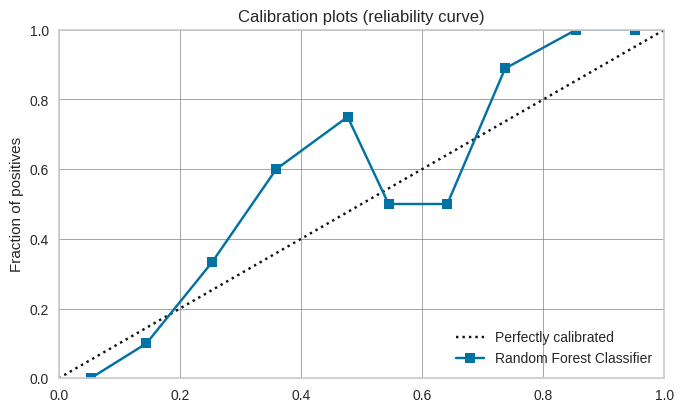

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [61]:
plot_model(rf, plot='calibration')


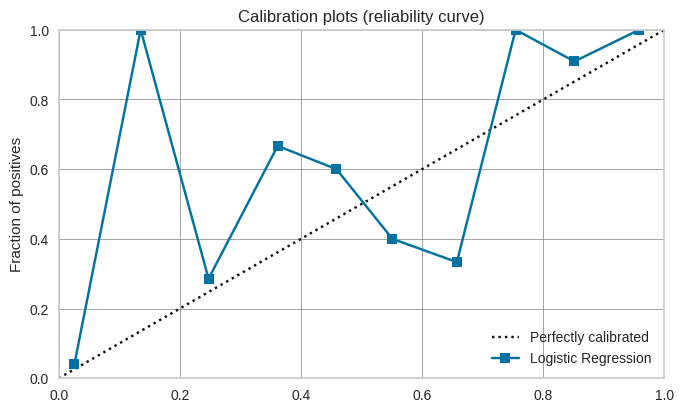

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [70]:
plot_model(tuned_lr, plot='calibration')


In [63]:
calibrated_rf = calibrate_model(rf)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7727,0.8917,0.7500,0.8182,0.7826,0.5455,0.5477
1,0.8636,0.9167,0.7500,1.0000,0.8571,0.7317,0.7596
2,0.9524,1.0000,1.0000,0.9167,0.9565,0.9041,0.9083
3,0.8571,0.9364,0.9091,0.8333,0.8696,0.7123,0.7156
4,0.8571,0.9273,0.9091,0.8333,0.8696,0.7123,0.7156
5,0.8095,0.8000,0.9091,0.7692,0.8333,0.6147,0.6264
6,0.8571,0.9182,0.9091,0.8333,0.8696,0.7123,0.7156
7,0.7619,0.8182,0.8182,0.7500,0.7826,0.5205,0.5230
8,0.8095,0.8636,0.7273,0.8889,0.8000,0.6216,0.6331


INFO:logs:create_model_container: 49
INFO:logs:master_model_container: 49
INFO:logs:display_container: 11
INFO:logs:CalibratedClassifierCV(base_estimator=RandomForestClassifier(bootstrap=True,
                                                             ccp_alpha=0.0,
                                                             class_weight=None,
                                                             criterion='gini',
                                                             max_depth=None,
                                                             max_features='auto',
                                                             max_leaf_nodes=None,
                                                             max_samples=None,
                                                             min_impurity_decrease=0.0,
                                                             min_impurity_split=None,
                                                             min_samples_leaf=

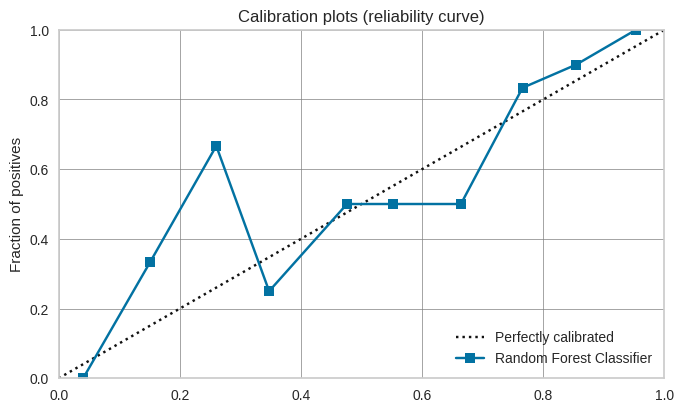

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [64]:
plot_model(calibrated_rf, plot='calibration')


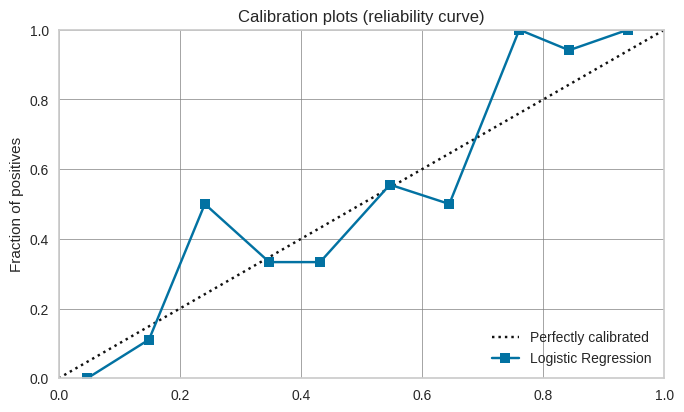

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [71]:
calibrate_lr = calibrate_model(tuned_lr)
plot_model(calibrate_lr, plot='calibration')


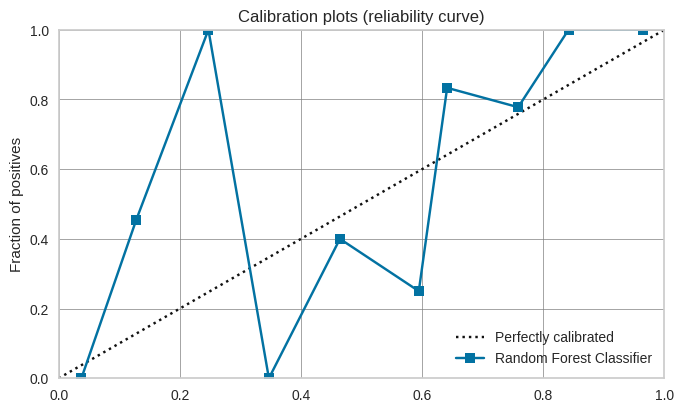

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [67]:
calibrated_rf_isotonic = calibrate_model(rf, method = 'isotonic')
plot_model(calibrated_rf_isotonic, plot='calibration')


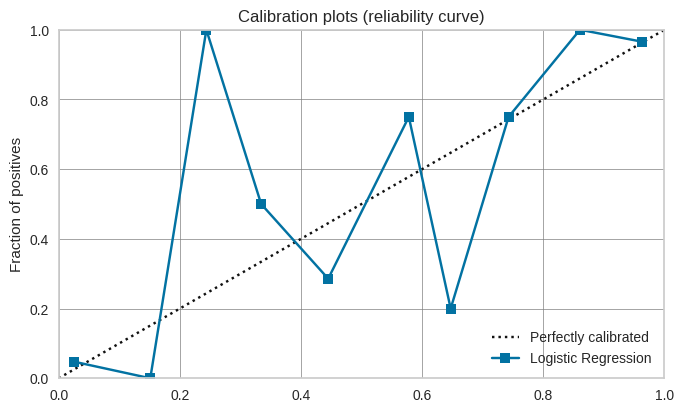

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [74]:
calibrated_lr_isotonic = calibrate_model(calibrate_lr, method = 'isotonic')
plot_model(calibrated_lr_isotonic, plot='calibration')


In [69]:
evaluate_model(calibrate_lr)

INFO:logs:Initializing evaluate_model()
INFO:logs:evaluate_model(estimator=CalibratedClassifierCV(base_estimator=LogisticRegression(C=1.0,
                                                         class_weight=None,
                                                         dual=False,
                                                         fit_intercept=True,
                                                         intercept_scaling=1,
                                                         l1_ratio=None,
                                                         max_iter=1000,
                                                         multi_class='auto',
                                                         n_jobs=None,
                                                         penalty='l2',
                                                         random_state=124,
                                                         solver='lbfgs',
                                                   

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…